In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import folium
import seaborn as sns

In [2]:
df_inspections=pd.read_csv('inspections.csv')
df_rests=pd.read_csv('rests.csv')

In [3]:
df_rests.rename(columns={'Unnamed: 0':'CAMIS'},inplace=True)
df_rests.head()

,CAMIS,DBA,CUISINE DESCRIPTION,BORO,BUILDING,STREET,ZIPCODE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,is_chain
0,30075445,MORRIS PARK BAKE SHOP,Bakery,Bronx,1007,MORRIS PARK AVE,10462.0,40.848231,-73.855972,211.0,13.0,25200.0,2045445.0,2.041270e+09,BX37,0
1,30112340,WENDY'S,Hamburgers,Brooklyn,469,FLATBUSH AVENUE,11225.0,40.662652,-73.962081,309.0,40.0,32700.0,3029737.0,3.011970e+09,BK60,1
2,30191841,DJ REYNOLDS PUB AND RESTAURANT,Irish,Manhattan,351,WEST 57 STREET,10019.0,40.767326,-73.984310,104.0,3.0,13900.0,1026048.0,1.010480e+09,MN15,0
3,40356018,RIVIERA CATERERS,American,Brooklyn,2780,STILLWELL AVENUE,11224.0,40.579920,-73.982090,313.0,47.0,34800.0,3347399.0,3.069970e+09,BK21,0
4,40356151,BRUNOS ON THE BOULEVARD,American,Queens,8825,ASTORIA BOULEVARD,11369.0,40.763971,-73.880973,403.0,22.0,32900.0,4024132.0,4.011000e+09,QN28,0


In [4]:
df_inspections.drop(columns=['Unnamed: 0'],inplace=True)
df_inspections['DATE']=pd.to_datetime(df_inspections['DATE'])
df_inspections.head()

,CAMIS,DATE,SCORE,INSPECTION TYPE,02A,02B,02C,02D,02E,02F,...,10D,10E,10F,10G,10H,10I,10J,ACTION,CRITICAL FLAG,GRADE
0,30075445,2017-05-18,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A
1,30075445,2018-05-11,5.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,0,A
2,30075445,2019-05-16,14.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,B
3,30075445,2019-06-11,6.0,Cycle Inspection / Re-inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,0,A
4,30112340,2016-04-12,0.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,No violations were recorded at the time of thi...,0,A


In [5]:
df_init=pd.read_csv('initial.csv')
df_init.drop(columns=['Unnamed: 0'],inplace=True)
df_init['DATE']=pd.to_datetime(df_init['DATE'])
df_init.head()

,CAMIS,DATE,SCORE,INSPECTION TYPE,02A,02B,02C,02D,02E,02F,...,10D,10E,10F,10G,10H,10I,10J,ACTION,CRITICAL FLAG,GRADE
0,30075445,2017-05-18,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A
1,30075445,2018-05-11,5.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,0,A
2,30075445,2019-05-16,14.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,B
3,30112340,2016-10-03,48.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,3,C
4,30112340,2017-06-26,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A


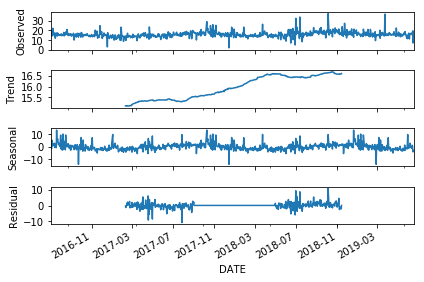

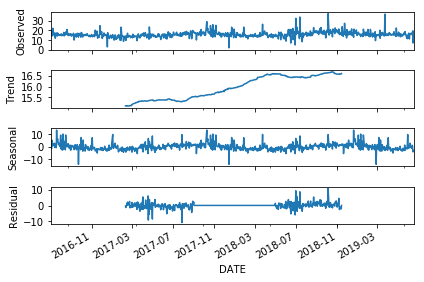

In [6]:

from statsmodels.tsa.seasonal import seasonal_decompose
result=seasonal_decompose(df_init.groupby('DATE')['SCORE'].mean(),freq=365)

result.plot()

In [7]:
df_inspections['SCORE'].describe()

count    112272.000000
mean         14.942773
std          10.943778
min           0.000000
25%           9.000000
50%          12.000000
75%          19.000000
max         166.000000
Name: SCORE, dtype: float64

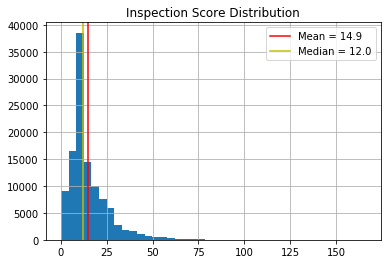

In [8]:
df_inspections['SCORE'].hist(bins=40)
plt.axvline(x=df_inspections['SCORE'].mean(),color='r',label=f'Mean = {round(df_inspections["SCORE"].mean(),1)}')
plt.axvline(x=df_inspections['SCORE'].median(),color='y',label=f'Median = {df_inspections["SCORE"].median()}')
plt.legend()
plt.title('Inspection Score Distribution')
plt.show()

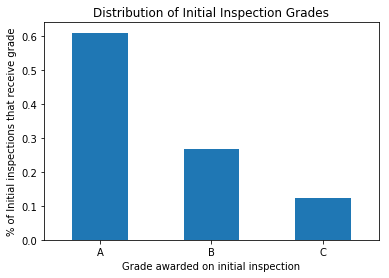

In [9]:
df_init['GRADE'].value_counts(normalize=True).plot(kind='bar')
plt.xticks(rotation=0)
plt.ylabel('% of Initial inspections that receive grade')
plt.xlabel('Grade awarded on initial inspection')
plt.title('Distribution of Initial Inspection Grades')
plt.show()

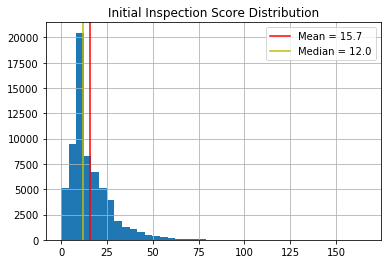

In [10]:
df_init['SCORE'].hist(bins=40)
plt.axvline(x=df_init['SCORE'].mean(),color='r',label=f'Mean = {round(df_init["SCORE"].mean(),1)}')
plt.axvline(x=df_init['SCORE'].median(),color='y',label=f'Median = {df_init["SCORE"].median()}')
plt.legend()
plt.title('Initial Inspection Score Distribution')
plt.show()

In [11]:
CBs=df_rests['Community Board'].dropna().unique()

In [12]:

def CB_ave_score(df):
    #takes input dataframe and returns new dataframe of community board and average score for inspections included in input dataframe
    a={}
    for cd in CBs:
        a[cd]=[]
        for cam in df_rests.loc[df_rests['Community Board']==cd]['CAMIS']:
            if np.isnan(np.mean(df.loc[df['CAMIS']==cam]['SCORE'])):
                pass
            else:                    
                a[cd].append(np.mean(df_init.loc[df_init['CAMIS']==cam]['SCORE']))
    b={}
    for cd in CBs:
        b[cd]=np.mean(a[cd])
   
    CB_ave=pd.DataFrame()
    CB_ave['Community Board']=b.keys()
    CB_ave['Community Board']=CB_ave['Community Board'].astype(int).astype(str)
    CB_ave['Average Score']=b.values()
    return CB_ave

In [13]:

def CB_med_score(df):
    #takes input dataframe and returns new dataframe of community board and median score for inspections included in input dataframe
    a={}
    for cd in CBs:
        a[cd]=[]
        for cam in df_rests.loc[df_rests['Community Board']==cd]['CAMIS']:
            if np.isnan(np.median(df.loc[df['CAMIS']==cam]['SCORE'])):
                pass
            else:                    
                a[cd].append(np.median(df_init.loc[df_init['CAMIS']==cam]['SCORE']))
    b={}
    for cd in CBs:
        b[cd]=np.median(a[cd])
   
    CB_med=pd.DataFrame()
    CB_med['Community Board']=b.keys()
    CB_med['Community Board']=CB_med['Community Board'].astype(int).astype(str)
    CB_med['Median Score']=b.values()
    return CB_med

In [14]:
df_CB_ave=CB_ave_score(df_init)

df_CB_ave.head()

,Community Board,Average Score
0,211,14.215814
1,309,16.391018
2,104,15.142581
3,313,14.439098
4,403,15.811228


In [15]:
df_CB_ave['Average Score'].describe()

count    69.000000
mean     14.471715
std       2.284318
min       5.666667
25%      14.215814
50%      15.031087
75%      15.742002
max      17.118769
Name: Average Score, dtype: float64

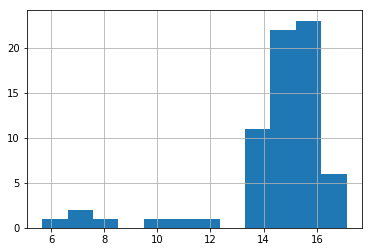

In [16]:
df_CB_ave['Average Score'].hist(bins=12)

In [17]:
df_CB_med=CB_med_score(df_init)

df_CB_med.head()

C:\Users\kosta\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\Users\kosta\Anaconda3\lib\site-packages\numpy\core\_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


,Community Board,Median Score
0,211,11.25
1,309,12.50
2,104,12.00
3,313,12.00
4,403,12.00


In [18]:
df_CB_med['Median Score'].describe()

count    69.000000
mean     11.623188
std       1.880933
min       4.000000
25%      12.000000
50%      12.000000
75%      12.500000
max      15.500000
Name: Median Score, dtype: float64

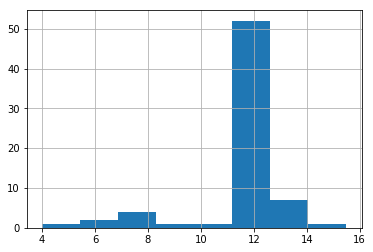

In [19]:
df_CB_med['Median Score'].hist(bins=8)

In [20]:
m_ave = folium.Map(location=[40.63, -73.855972], zoom_start=10)

folium.Choropleth(
    geo_data='Community Districts.geojson',
    name='choropleth',
    data=df_CB_ave,
    columns=['Community Board', 'Average Score'],
    key_on='feature.properties.boro_cd',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Average Restaurant Initial inspection score'
).add_to(m_ave)

m_ave

In [21]:
m_med = folium.Map(location=[40.63, -73.855972], zoom_start=10)

folium.Choropleth(
    geo_data='Community Districts.geojson',
    name='choropleth',
    data=df_CB_med,
    columns=['Community Board', 'Median Score'],
    key_on='feature.properties.boro_cd',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Median Restaurant Initial inspection score'
).add_to(m_med)

m_med

In [22]:
df_init_2019=df_init.loc[df_init['DATE']>'2019']
df_init_2018=df_init.loc[(df_init['DATE']<'2019')&(df_init['DATE']>'2018')]
df_init_2017=df_init.loc[(df_init['DATE']<'2018')&(df_init['DATE']>'2017')]
df_init_2016=df_init.loc[(df_init['DATE']<'2017')&(df_init['DATE']>'2016')]

In [23]:
df_cb_ave_2019=CB_ave_score(df_init_2019)
df_cb_ave_2018=CB_ave_score(df_init_2018)
df_cb_ave_2017=CB_ave_score(df_init_2017)
df_cb_ave_2016=CB_ave_score(df_init_2016)

C:\Users\kosta\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
C:\Users\kosta\Anaconda3\lib\site-packages\numpy\core\_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


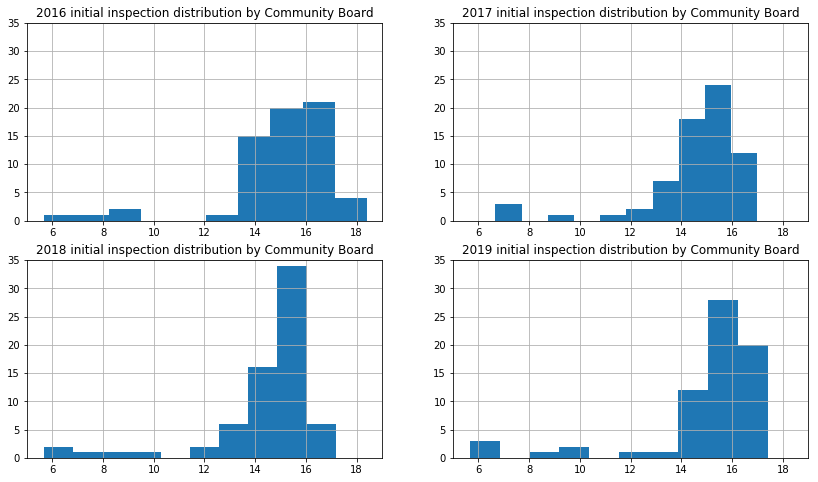

In [24]:
plt.figure(figsize=(14,8))
plt.subplot(2,2,1)
df_cb_ave_2016['Average Score'].hist()
plt.xlim((5,19))
plt.ylim((0,35))
plt.title('2016 initial inspection distribution by Community Board')
plt.subplot(2,2,2)
df_cb_ave_2017['Average Score'].hist()
plt.xlim((5,19))
plt.ylim((0,35))
plt.title('2017 initial inspection distribution by Community Board')
plt.subplot(2,2,3)
df_cb_ave_2018['Average Score'].hist()
plt.xlim((5,19))
plt.ylim((0,35))
plt.title('2018 initial inspection distribution by Community Board')
plt.subplot(2,2,4)
df_cb_ave_2019['Average Score'].hist()
plt.xlim((5,19))
plt.ylim((0,35))
plt.title('2019 initial inspection distribution by Community Board')
plt.show()

C:\Users\kosta\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


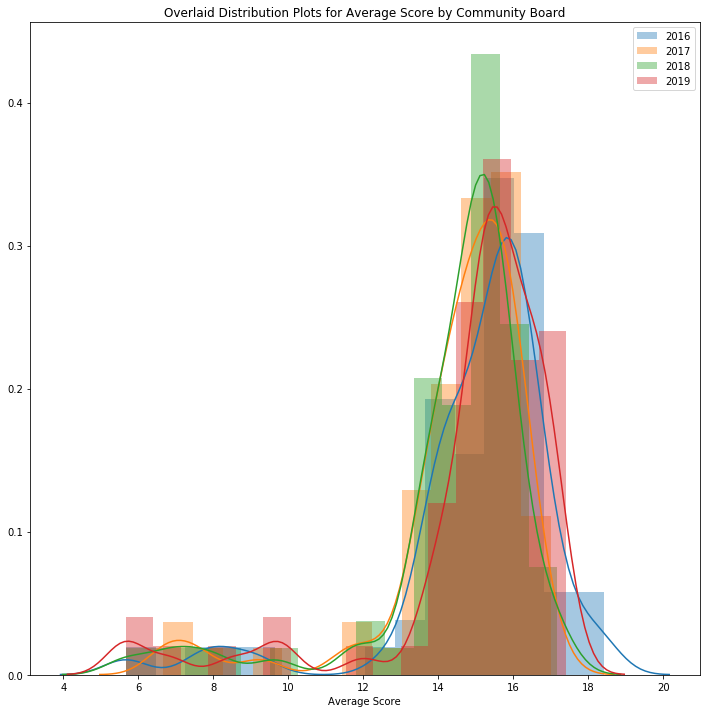

In [25]:
plt.figure(figsize=(12,12))
sns.distplot(df_cb_ave_2016['Average Score'].dropna(),label='2016')
sns.distplot(df_cb_ave_2017['Average Score'].dropna(),label='2017')
sns.distplot(df_cb_ave_2018['Average Score'].dropna(),label='2018')
sns.distplot(df_cb_ave_2019['Average Score'].dropna(),label='2019')
plt.title('Overlaid Distribution Plots for Average Score by Community Board')
plt.legend()
plt.show()
# df_cb_ave_2016['Average Score'].hist()
# df_cb_ave_2017['Average Score'].hist()
# df_cb_ave_2018['Average Score'].hist()
# df_cb_ave_2019['Average Score'].hist()

In [26]:
m_ave_yronyr = folium.Map(location=[40.63, -73.855972], zoom_start=10)

for yr,df in zip([2016,2017,2018,2019],[df_cb_ave_2016,df_cb_ave_2017,df_cb_ave_2018,df_cb_ave_2019]):
    
    folium.Choropleth(
        geo_data='Community Districts.geojson',
        name=yr,
        data=df,
        columns=['Community Board', 'Average Score'],
        key_on='feature.properties.boro_cd',
        fill_color='OrRd',
        fill_opacity=0.6,
        line_opacity=0.5,
        legend_name='Average Restaurant Initial inspection score '+str(yr)
    ).add_to(m_ave_yronyr)
    
folium.LayerControl().add_to(m_ave_yronyr)
m_ave_yronyr

In [27]:
df_CB_ave_yr_change=pd.DataFrame()
df_CB_ave_yr_change['Community Board']=CBs.astype(str)
df_CB_ave_yr_change['2016']=df_cb_ave_2016['Average Score']
df_CB_ave_yr_change['2017']=df_cb_ave_2017['Average Score']
df_CB_ave_yr_change['2018']=df_cb_ave_2018['Average Score']
df_CB_ave_yr_change['2019']=df_cb_ave_2019['Average Score']
df_CB_ave_yr_change['average']=df_CB_ave['Average Score']
df_CB_ave_yr_change.head()

,Community Board,2016,2017,2018,2019,average
0,211.0,13.531356,13.781740,14.159918,14.799294,14.215814
1,309.0,17.803107,16.309760,16.831982,15.782041,16.391018
2,104.0,15.782726,15.213922,15.132093,15.628010,15.142581
3,313.0,14.082946,14.978993,14.669306,15.514683,14.439098
4,403.0,15.863990,15.812409,15.941667,16.588813,15.811228


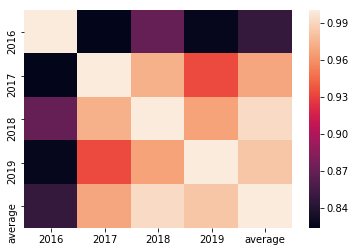

In [28]:
sns.heatmap(abs(df_CB_ave_yr_change.corr()))

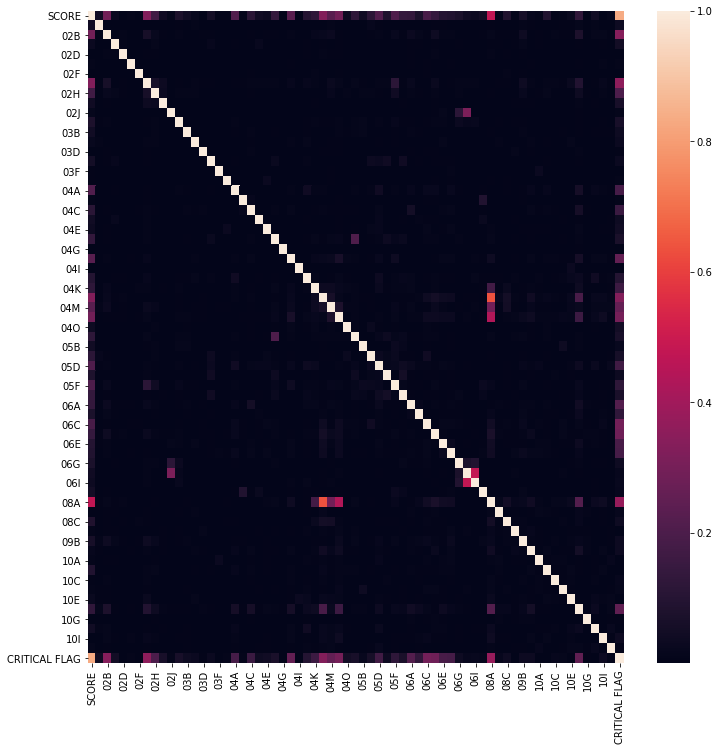

In [29]:
plt.figure(figsize=(12,12))
sns.heatmap(abs(df_init.drop(columns=['CAMIS']).corr()))

In [30]:
sum(abs(df_init.corr()['SCORE'])>0.3)

5

In [31]:
df_init.sum()

CAMIS                                                  2986272253601
SCORE                                                    1.03664e+06
INSPECTION TYPE    Cycle Inspection / Initial InspectionCycle Ins...
02A                                                              143
02B                                                            11141
02C                                                              246
02D                                                               31
02E                                                                4
02F                                                                8
02G                                                            12047
02H                                                             2823
02I                                                              209
02J                                                                1
03A                                                              345
03B                               

In [32]:
abs(df_init.corr()['SCORE']).sort_values(ascending=False).head()

SCORE            1.000000
CRITICAL FLAG    0.833407
08A              0.475213
04L              0.330653
02G              0.324326
Name: SCORE, dtype: float64

In [33]:
df_init['CRITICAL FLAG'].describe()

count    65932.000000
mean         1.726112
std          1.246251
min          0.000000
25%          1.000000
50%          1.000000
75%          2.000000
max         13.000000
Name: CRITICAL FLAG, dtype: float64

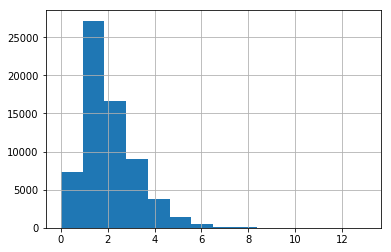

In [34]:
df_init['CRITICAL FLAG'].hist(bins=14)

In [35]:
scores_crity=df_init.loc[df_init['CRITICAL FLAG']>=1]['SCORE']
scores_critn=df_init.loc[df_init['CRITICAL FLAG']==0]['SCORE']

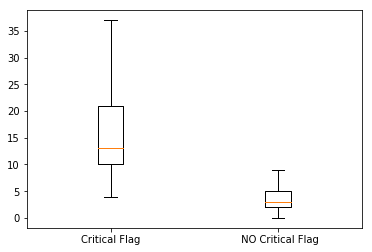

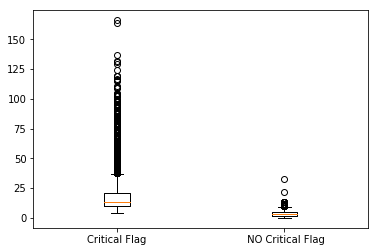

In [36]:
plt.boxplot([scores_crity,scores_critn],showfliers=False)
plt.xticks([1,2],['Critical Flag',' NO Critical Flag'])
plt.show()
plt.boxplot([scores_crity,scores_critn])
plt.xticks([1,2],['Critical Flag',' NO Critical Flag'])
plt.show()

In [37]:
scores_critn.describe()

count    7316.000000
mean        3.667851
std         2.162531
min         0.000000
25%         2.000000
50%         3.000000
75%         5.000000
max        33.000000
Name: SCORE, dtype: float64

In [39]:
df_cycles=pd.read_csv('cycles.csv')
df_cycles.head()

,Unnamed: 0,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,...,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
0,0,50032783,GINZA,Manhattan,800,LEXINGTON AVE,10065.0,2128887898,Japanese,2018-10-23,...,08/13/2019,Cycle Inspection / Initial Inspection,40.763962,-73.966929,108.0,4.0,11402.0,1042000.0,1.013960e+09,MN40
1,1,40859145,ROCCO'S PIZZERIA,Brooklyn,123,BRIGHTON BEACH AVENUE,11235.0,7183729180,Pizza/Italian,2018-11-16,...,08/13/2019,Cycle Inspection / Initial Inspection,40.576341,-73.967487,313.0,48.0,36200.0,3244587.0,3.086690e+09,BK19
2,2,50035038,DIVIERA DRIVE,Brooklyn,131,BERRY ST,11249.0,3479874302,Italian,2016-05-05,...,08/13/2019,Cycle Inspection / Re-inspection,40.718424,-73.959214,301.0,33.0,55300.0,3340970.0,3.023270e+09,BK73
3,3,50054476,DUN-WELL DOUGHNUTS,Manhattan,102,SAINT MARKS PL,10009.0,6469985492,Donuts,2017-08-08,...,08/13/2019,Cycle Inspection / Initial Inspection,40.727368,-73.984796,103.0,2.0,3200.0,1005826.0,1.004350e+09,MN22
4,4,41286239,BLANQUITA RESTAURANT,Bronx,2647,BRIGGS AVENUE,10458.0,7183295851,"Latin (Cuban, Dominican, Puerto Rican, South &...",2017-03-28,...,08/13/2019,Cycle Inspection / Initial Inspection,40.865382,-73.892469,207.0,15.0,40501.0,2016992.0,2.033000e+09,BX05


In [41]:
scores_crity.describe()

count    58616.000000
mean        17.227515
std         11.169634
min          4.000000
25%         10.000000
50%         13.000000
75%         21.000000
max        166.000000
Name: SCORE, dtype: float64

In [42]:
ins_count=[]
CAMIS=df_init['CAMIS'].unique()
for cam in CAMIS:
    ins_count.append(len(df_init.loc[df_init['CAMIS']==cam]))

In [43]:
np.mean(ins_count)

2.991741537344587

In [44]:
np.min(ins_count)

1

In [45]:
np.max(ins_count)

7

Text(0.5,1,'Rate of Cycle/Initial Inspections per restaurant')

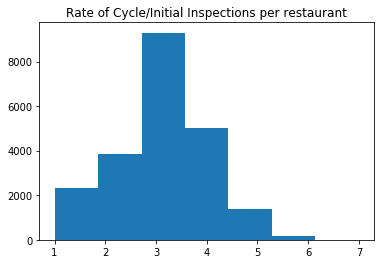

In [46]:
plt.hist(ins_count,bins=7,)
plt.title('Rate of Cycle/Initial Inspections per restaurant')

In [47]:
pd.Series(ins_count).value_counts()

3    9292
4    5008
2    3856
1    2317
5    1396
6     168
7       1
dtype: int64

In [48]:
df_init_sum=pd.DataFrame()
df_init_sum['CAMIS']=CAMIS
df_init_sum['ins_count']=ins_count
twice_ins=df_init_sum.loc[df_init_sum['ins_count']>=2]['CAMIS'].values
df_twice_init=df_init.loc[df_init['CAMIS'].isin(twice_ins)]

In [49]:
len(df_twice_init)

63615

In [52]:
prev=[]
for cam,date in zip(df_twice_init['CAMIS'],df_twice_init['DATE']):
    if len(df_init.loc[(df_init['CAMIS']==cam)&(df_init['DATE']<date)]['SCORE'])>0:
        prev.append(df_init.loc[(df_init['CAMIS']==cam)&(df_init['DATE']<date)]['SCORE'].iloc[-1])
    else:
        prev.append(np.nan)
df_twice_init['prev_score']=prev                

C:\Users\kosta\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys


In [53]:
len(df_twice_init['CAMIS'].unique())

19721

In [54]:
df_twice_init[['SCORE','prev_score']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 63615 entries, 0 to 65801
Data columns (total 2 columns):
SCORE         63615 non-null float64
prev_score    43894 non-null float64
dtypes: float64(2)
memory usage: 1.5 MB


In [55]:
df_twice_init.head()

,CAMIS,DATE,SCORE,INSPECTION TYPE,02A,02B,02C,02D,02E,02F,...,10E,10F,10G,10H,10I,10J,ACTION,CRITICAL FLAG,GRADE,prev_score
0,30075445,2017-05-18,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A,NaN
1,30075445,2018-05-11,5.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,0,A,7.0
2,30075445,2019-05-16,14.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,B,5.0
3,30112340,2016-10-03,48.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,3,C,NaN
4,30112340,2017-06-26,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A,48.0


In [56]:
df_twice_init.dropna(inplace=True)

C:\Users\kosta\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [57]:
df_twice_init.head()

,CAMIS,DATE,SCORE,INSPECTION TYPE,02A,02B,02C,02D,02E,02F,...,10E,10F,10G,10H,10I,10J,ACTION,CRITICAL FLAG,GRADE,prev_score
1,30075445,2018-05-11,5.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,0,A,7.0
2,30075445,2019-05-16,14.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,B,5.0
4,30112340,2017-06-26,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A,48.0
5,30112340,2018-03-13,12.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A,7.0
6,30112340,2019-03-04,13.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A,12.0


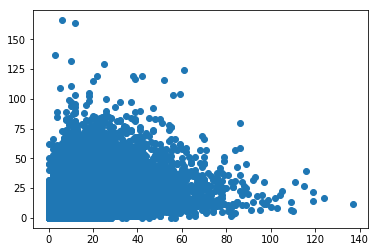

In [59]:
plt.scatter(df_twice_init['prev_score'],df_twice_init['SCORE'])

In [61]:
df_twice_init[['SCORE','prev_score']].corr()

,SCORE,prev_score
SCORE,1.000000,0.232972
prev_score,0.232972,1.000000


In [62]:
prev_crit=[]
for cam,date in zip(df_twice_init['CAMIS'],df_twice_init['DATE']):
    prev_crit.append(df_init.loc[(df_init['CAMIS']==cam)&(df_init['DATE']<date)]['CRITICAL FLAG'].iloc[-1])
df_twice_init['prev_critical']=prev_crit          
df_twice_init.head()

C:\Users\kosta\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


,CAMIS,DATE,SCORE,INSPECTION TYPE,02A,02B,02C,02D,02E,02F,...,10F,10G,10H,10I,10J,ACTION,CRITICAL FLAG,GRADE,prev_score,prev_critical
1,30075445,2018-05-11,5.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,0,A,7.0,1
2,30075445,2019-05-16,14.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,B,5.0,0
4,30112340,2017-06-26,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A,48.0,3
5,30112340,2018-03-13,12.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A,7.0,1
6,30112340,2019-03-04,13.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,Violations were cited in the following area(s).,1,A,12.0,1


In [91]:
df_twice_init[['CRITICAL FLAG','prev_critical']].corr()

,CRITICAL FLAG,prev_critical
CRITICAL FLAG,1.000000,0.266088
prev_critical,0.266088,1.000000


In [63]:
len(prev_crit)

43894

In [64]:
df_cuis_score=pd.DataFrame()
df_cuis_score['CAMIS']=df_rests.CAMIS
df_cuis_score['Cuisine']=df_rests['CUISINE DESCRIPTION']
cuis_ave_score=[]
for camis in df_cuis_score['CAMIS']:
    cuis_ave_score.append(np.mean(df_init.loc[df_init['CAMIS']==camis]['SCORE']))
df_cuis_score['Average Score']=cuis_ave_score
df_cuis_score.head()
                          

,CAMIS,Cuisine,Average Score
0,30075445,Bakery,8.666667
1,30112340,Hamburgers,20.000000
2,30191841,Irish,11.000000
3,40356018,American,11.500000
4,40356151,American,25.000000


In [65]:
df_cuis_score[['Cuisine','Average Score']].groupby('Cuisine').mean().sort_values('Average Score')

,Average Score
Cuisine,
Hotdogs,7.706522
Hotdogs/Pretzels,9.583333
Basque,10.000000
Donuts,10.024230
Nuts/Confectionary,10.041667
Soups,10.300000
"Ice Cream, Gelato, Yogurt, Ices",10.639695
Not Listed/Not Applicable,10.964286
Sandwiches,11.258230


(array([ 2.,  8., 12., 22., 21., 12.,  3.,  1.,  2.,  1.]),
 array([ 7.70652174,  9.71086957, 11.71521739, 13.71956522, 15.72391304,
        17.72826087, 19.7326087 , 21.73695652, 23.74130435, 25.74565217,
        27.75      ]),
 <a list of 10 Patch objects>)

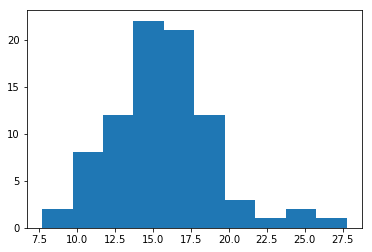

In [66]:
plt.hist(df_cuis_score[['Cuisine','Average Score']].groupby('Cuisine').mean().sort_values('Average Score').values)

In [67]:
df_cuis_score[['Cuisine','Average Score']].groupby('Cuisine').mean().sort_values('Average Score').describe()

,Average Score
count,84.000000
mean,15.584135
std,3.447564
min,7.706522
25%,13.674310
50%,15.522747
75%,17.514547
max,27.750000


In [68]:
df_init['ACTION'].value_counts()

Violations were cited in the following area(s).                                                                                        64047
Establishment Closed by DOHMH.  Violations were cited in the following area(s) and those requiring immediate action were addressed.     1405
No violations were recorded at the time of this inspection.                                                                              480
Name: ACTION, dtype: int64

In [69]:
# correlate CB restaurant count with average score - more restaurants in the neighbourhood help or hinder? sharing best practices?
df_CB_ave

,Community Board,Average Score
0,211,14.215814
1,309,16.391018
2,104,15.142581
3,313,14.439098
4,403,15.811228
5,318,13.531786
6,317,15.871066
7,206,14.789697
8,108,15.489331
9,315,15.031087


In [70]:
df_rests['Community Board'].value_counts()

105.0    2080
102.0    1085
103.0    1077
104.0     936
301.0     750
407.0     727
106.0     720
101.0     712
108.0     692
401.0     639
302.0     589
306.0     501
107.0     484
402.0     413
307.0     402
403.0     390
405.0     367
412.0     354
404.0     353
112.0     344
310.0     332
311.0     329
501.0     314
303.0     291
315.0     290
304.0     278
308.0     259
502.0     256
314.0     255
411.0     255
         ... 
413.0     221
110.0     214
408.0     213
305.0     210
109.0     210
317.0     205
209.0     195
212.0     194
211.0     176
201.0     174
309.0     172
206.0     169
207.0     167
208.0     160
205.0     156
313.0     137
483.0     116
414.0     114
316.0      87
202.0      84
203.0      80
480.0      58
481.0      10
164.0       9
228.0       6
355.0       4
227.0       3
226.0       2
595.0       1
482.0       1
Name: Community Board, Length: 69, dtype: int64

In [71]:
cb_count=[]
for cb in CBs:
    cb_count.append(len(df_rests.loc[df_rests['Community Board']==cb]))
df_CB_ave['Count']=cb_count

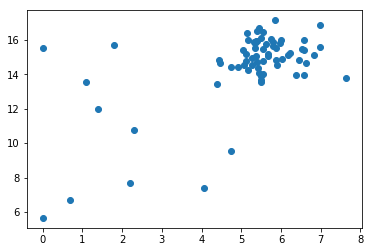

In [72]:
plt.scatter(np.log(df_CB_ave['Count']),df_CB_ave['Average Score'])

(array([25., 31.,  3.,  6.,  1.,  2.,  0.,  0.,  0.,  1.]),
 array([1.0000e+00, 2.0890e+02, 4.1680e+02, 6.2470e+02, 8.3260e+02,
        1.0405e+03, 1.2484e+03, 1.4563e+03, 1.6642e+03, 1.8721e+03,
        2.0800e+03]),
 <a list of 10 Patch objects>)

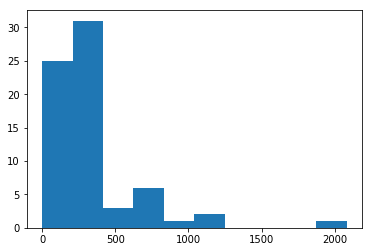

In [73]:
plt.hist((df_CB_ave['Count']))

(array([ 3.,  2.,  2.,  1.,  0.,  4., 15., 29., 10.,  3.]),
 array([0.        , 0.76401232, 1.52802463, 2.29203695, 3.05604927,
        3.82006159, 4.5840739 , 5.34808622, 6.11209854, 6.87611086,
        7.64012317]),
 <a list of 10 Patch objects>)

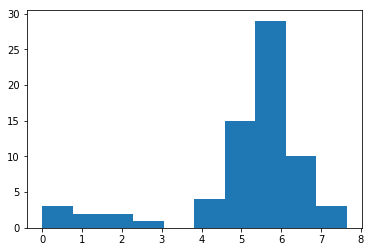

In [74]:
plt.hist(np.log(df_CB_ave['Count']))

In [75]:
df_rests['is_chain'].value_counts(normalize=True)

0    0.749811
1    0.250189
Name: is_chain, dtype: float64

In [76]:
df_merged=df_init.merge(df_rests[['CAMIS','DBA','CUISINE DESCRIPTION','is_chain','Community Board','Latitude','Longitude']],on='CAMIS')
df_merged.head()

,CAMIS,DATE,SCORE,INSPECTION TYPE,02A,02B,02C,02D,02E,02F,...,10J,ACTION,CRITICAL FLAG,GRADE,DBA,CUISINE DESCRIPTION,is_chain,Community Board,Latitude,Longitude
0,30075445,2017-05-18,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Violations were cited in the following area(s).,1,A,MORRIS PARK BAKE SHOP,Bakery,0,211.0,40.848231,-73.855972
1,30075445,2018-05-11,5.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Violations were cited in the following area(s).,0,A,MORRIS PARK BAKE SHOP,Bakery,0,211.0,40.848231,-73.855972
2,30075445,2019-05-16,14.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Violations were cited in the following area(s).,1,B,MORRIS PARK BAKE SHOP,Bakery,0,211.0,40.848231,-73.855972
3,30112340,2016-10-03,48.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Violations were cited in the following area(s).,3,C,WENDY'S,Hamburgers,1,309.0,40.662652,-73.962081
4,30112340,2017-06-26,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Violations were cited in the following area(s).,1,A,WENDY'S,Hamburgers,1,309.0,40.662652,-73.962081


In [77]:
df_merged.loc[df_merged['is_chain']==0]['SCORE'].describe()

count    49135.000000
mean        16.435637
std         11.610397
min          0.000000
25%          9.000000
50%         12.000000
75%         21.000000
max        166.000000
Name: SCORE, dtype: float64

In [78]:
df_merged.loc[df_merged['is_chain']==1]['SCORE'].describe()

count    16797.000000
mean        13.637971
std         10.414274
min          0.000000
25%          7.000000
50%         11.000000
75%         17.000000
max        137.000000
Name: SCORE, dtype: float64

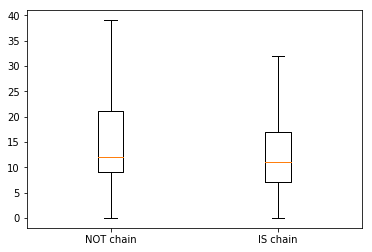

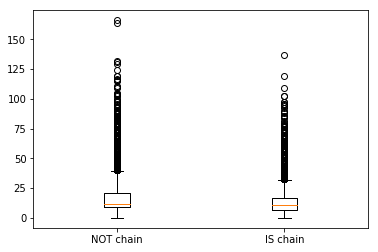

In [79]:
plt.boxplot([df_merged.loc[df_merged['is_chain']==0]['SCORE'],df_merged.loc[df_merged['is_chain']==1]['SCORE']],showfliers=False)
plt.xticks([1,2],['NOT chain','IS chain'])
plt.show()
plt.boxplot([df_merged.loc[df_merged['is_chain']==0]['SCORE'],df_merged.loc[df_merged['is_chain']==1]['SCORE']])
plt.xticks([1,2],['NOT chain','IS chain'])
plt.show()

In [80]:
from scipy import stats
t_stat, p= stats.ttest_ind(df_merged.loc[df_merged['is_chain']==1]['SCORE'],df_merged.loc[df_merged['is_chain']==0]['SCORE'],equal_var=False)
print('T-test p-value :',p)

T-test p-value : 1.306083944817936e-184


C:\Users\kosta\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


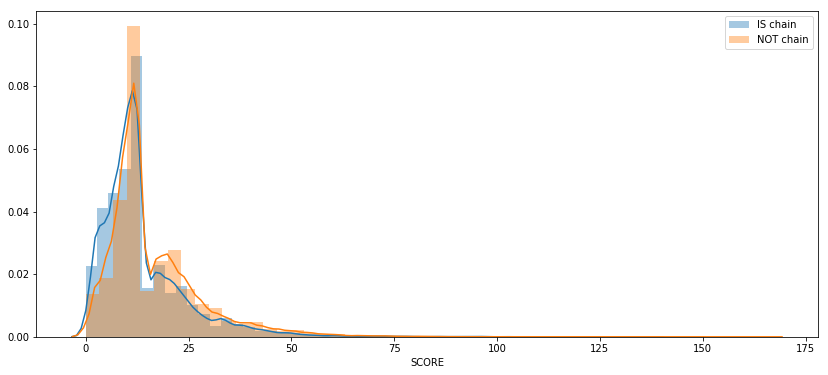

In [81]:
plt.figure(figsize=(14,6))
sns.distplot(df_merged.loc[df_merged['is_chain']==1]['SCORE'],label='IS chain')
sns.distplot(df_merged.loc[df_merged['is_chain']==0]['SCORE'],label='NOT chain')
plt.legend()
plt.show()

In [82]:
df_twice_merged=df_twice_init.merge(df_rests[['CAMIS','DBA','CUISINE DESCRIPTION','is_chain','Community Board','Latitude','Longitude']],on='CAMIS')
df_twice_merged.head()

,CAMIS,DATE,SCORE,INSPECTION TYPE,02A,02B,02C,02D,02E,02F,...,CRITICAL FLAG,GRADE,prev_score,prev_critical,DBA,CUISINE DESCRIPTION,is_chain,Community Board,Latitude,Longitude
0,30075445,2018-05-11,5.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,0,A,7.0,1,MORRIS PARK BAKE SHOP,Bakery,0,211.0,40.848231,-73.855972
1,30075445,2019-05-16,14.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,1,B,5.0,0,MORRIS PARK BAKE SHOP,Bakery,0,211.0,40.848231,-73.855972
2,30112340,2017-06-26,7.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,1,A,48.0,3,WENDY'S,Hamburgers,1,309.0,40.662652,-73.962081
3,30112340,2018-03-13,12.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,1,A,7.0,1,WENDY'S,Hamburgers,1,309.0,40.662652,-73.962081
4,30112340,2019-03-04,13.0,Cycle Inspection / Initial Inspection,0.0,0.0,0.0,0.0,0.0,0.0,...,1,A,12.0,1,WENDY'S,Hamburgers,1,309.0,40.662652,-73.962081


In [84]:
df_merged.groupby('CUISINE DESCRIPTION')['SCORE'].mean().sort_values()

CUISINE DESCRIPTION
Hotdogs                                                              7.968750
Nuts/Confectionary                                                   8.125000
Hotdogs/Pretzels                                                     8.964912
Basque                                                              10.000000
Donuts                                                              10.479868
Ice Cream, Gelato, Yogurt, Ices                                     10.969372
Not Listed/Not Applicable                                           11.368421
Sandwiches                                                          11.904517
Café/Coffee/Tea                                                     12.224769
Bottled beverages, including water, sodas, juices, etc.             12.239130
Hamburgers                                                          12.333962
Sandwiches/Salads/Mixed Buffet                                      12.525620
Soups                                       

In [85]:
df_merged.groupby('CUISINE DESCRIPTION')['SCORE'].mean().describe()

count    84.000000
mean     16.123009
std       3.552806
min       7.968750
25%      14.100746
50%      16.249314
75%      18.062420
max      27.750000
Name: SCORE, dtype: float64

In [89]:
df_merged.groupby('Community Board')['SCORE'].mean()

Community Board
101.0    14.684808
102.0    16.493172
103.0    17.736706
104.0    15.768121
105.0    14.678484
106.0    16.747238
107.0    15.930505
108.0    16.027832
109.0    16.032841
110.0    16.457050
111.0    16.658038
112.0    17.875752
164.0     8.272727
201.0    16.512524
202.0    15.083665
203.0    13.528889
204.0    15.248074
205.0    15.828025
206.0    15.024194
207.0    15.737255
208.0    15.179752
209.0    14.732620
210.0    14.649351
211.0    14.526820
212.0    15.393888
226.0     6.666667
227.0    14.250000
228.0    15.473684
301.0    15.308852
302.0    14.712148
           ...    
312.0    16.757480
313.0    15.432292
314.0    16.820580
315.0    15.853828
316.0    15.566265
317.0    16.284314
318.0    14.498607
355.0    12.000000
401.0    15.493697
402.0    15.636290
403.0    16.659751
404.0    16.407993
405.0    14.999057
406.0    14.215739
407.0    16.105212
408.0    15.657729
409.0    16.974648
410.0    14.308943
411.0    14.611185
412.0    15.519685
413.0    15.658

In [88]:
df_merged.SCORE.describe()

count    65932.000000
mean        15.722896
std         11.383062
min          0.000000
25%          9.000000
50%         12.000000
75%         20.000000
max        166.000000
Name: SCORE, dtype: float64